# Генетические алгоритмы для решения задачи коммивояжера
### Визуализация поиска решения и анализ качества алгоритма

Для построение графиков и анимаций будем использовать библиотеки `matplotlib` и `plotly.graph_objects`.
Добавим все необходимые библиотеки.

In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import sys
sys.path.append('/content/gdrive/My Drive/Генетический алгоритм/algorithms/genetic')
sys.path.append('/content/gdrive/My Drive/Генетический алгоритм/algorithms')
sys.path.append('/content/gdrive/My Drive/Генетический алгоритм')

In [ ]:
import pandas as pd
import plotly.graph_objects as go
from matplotlib import pyplot as plt
import seaborn as sns
import copy

sns.set(style="darkgrid")

from genetic import GeneticAlgorithm
from creation import RandomCreation, EfficientCreation
from selection import RouletteSelection, RankSelection
from crossover import InbreedingParentGenerator, EdgeRecombinationCrossover, PanmixiaParentGenerator, OrderCrossover
from mutation import TwoOptMutation, SwapMutation
from species import Species

from tsp import TSP
from typing import List
import numpy as np

Создадим функцию для сохранения информации о городах для TSP из текстового файла в `DataFrame`

In [ ]:
def get_cities_df(file_path: str):
    cities_df = pd.read_csv(file_path, sep=' ', header=None)
    cities_df.columns = ['name', 'x', 'y']
    return cities_df

In [ ]:
file_path = '/content/gdrive/MyDrive/Генетический алгоритм/tests/50cities_1.txt'
cities_df = get_cities_df(file_path)

Посмотрим на сохраненный нами тест для 50 городов.

In [ ]:
cities_df.head(7)

,name,x,y
0,1,230,166
1,2,92,66
2,3,39,47
3,4,218,207
4,5,64,197
5,6,133,130
6,7,238,91


Напишем функцию инициализации задачи коммивояжера

In [ ]:
def init_tsp(cities_df: pd.DataFrame):
    cities: List[TSP.City] = []
    for _, row in cities_df.iterrows():
        id, x, y = row['name'], row['x'], row['y']
        cities.append(TSP.City(id, int(x), int(y)))
    return TSP(cities)

Теперь передадим задачу в генетический алгоритм с наилучшими параметрами (подобранными ранее) и запустим ее

In [ ]:
tsp = init_tsp(cities_df)

ga_settings = GeneticAlgorithm.Settings(creation=EfficientCreation(1000, tsp, 0.3),
                                        selection=RouletteSelection(0.7),
                                        parent_generator=InbreedingParentGenerator(),
                                        crossover=EdgeRecombinationCrossover(),
                                        mutation=TwoOptMutation(0.1),
                                        survived=0.7,
                                        mutated=0.1)

ga = GeneticAlgorithm(ga_settings)

In [ ]:
%%time
dist = ga.solve(tsp)

print("Genetic Algorithm: ", dist)

Genetic Algorithm:  2058.8904667132883
CPU times: user 1min 6s, sys: 323 ms, total: 1min 7s
Wall time: 1min 12s


Реализуем функцию, которая будет рисовать график-анимацию нахождения решения

In [ ]:
def plot_tsp(cities_df, tsp, title):
    points = go.Scatter(x=cities_df['x'], y=cities_df['y'], mode='markers',
                        marker=dict(color='#5D69B1', size=10), name='Город',
                        text = ["Название: {}".format(name) for name in cities_df['name'] ])

    paths_history, distances_history = tsp.get_solutions_history()
    answer = paths_history[-1]

    path = go.Scatter(x=answer[0], y=answer[1], mode='lines', name="Маршрут")

    button = {
            "type": "buttons",
            "buttons": [
                {
                    "label": "Запустить",
                    "method": "animate",
                    "args": [None, {"frame": {"duration": 180},
                                    "fromcurrent": True}],
                },
                {
                    "label": "Остановить",
                    "method": "animate",
                    "args": [[None], {"frame": {"duration": 0, "redraw": False},
                                      "mode": "immediate",
                                      "transition": {"duration": 0}}],
                }
            ],
        }

    frames = []
    for i in range(len(paths_history)):
        path = go.Scatter(x=paths_history[i][0], y=paths_history[i][1], mode='lines', name="Маршрут")
        layout = go.Layout(updatemenus=[button],
                           title_text=f"Маршрут, найденный {title} за {i + 1} итераций, " +
                                      f"длина маршрута = {distances_history[i]}")
        frame = go.Frame(data=[points, path], layout=layout)
        frames.append(frame)


    fig = go.Figure(data=[points, path], frames=frames, layout=layout)
    fig.show()

In [ ]:
plot_tsp(cities_df, tsp, "Genetic Algorithm")

In [ ]:
def run(tsp: TSP, algorithm, attempts: int, logging=True):
    min_dist = float('inf')
    best_tsp = None

    for attempt in range(attempts):
        tsp.clear_answer()
        dist = algorithm.solve(tsp, logging)
        if dist < min_dist:
            min_dist = dist
            if logging:
                best_tsp = copy.deepcopy(tsp)

        print(attempt)

    return best_tsp if logging else min_dist

In [ ]:
def get_solution(file_path: str, algorithm, attempts=1, logging=True):
    cities_df = get_cities_df(file_path)
    tsp = init_tsp(cities_df)
    return cities_df, run(tsp, algorithm, attempts, logging)

In [ ]:
%%time
file_path = '/content/gdrive/MyDrive/Генетический алгоритм/tests/lin105.txt'

cities_df = get_cities_df(file_path)
tsp = init_tsp(cities_df)
ga_settings = GeneticAlgorithm.Settings(creation = RandomCreation(5000),
                                               selection = RouletteSelection(0.7),
                                               mutation = TwoOptMutation(0.1),
                                               parent_generator= InbreedingParentGenerator(),
                                               crossover=EdgeRecombinationCrossover(),
                                               iterations=500,
                                               population_size=5000,
                                               survived=0.7,
                                               mutated=0.1)

ga = GeneticAlgorithm(ga_settings)

tsp = run(tsp, ga, attempts=1, logging=True)
plot_tsp(cities_df, tsp, 'Genetic Algorithm')

0


CPU times: user 10min 23s, sys: 2.78 s, total: 10min 26s
Wall time: 10min 33s


Чтобы сохранять полученные графики, сделаем функцию, которая по имени будет подбирать порядковый номер так, чтобы старые картинки не перезатирались.

In [ ]:
import os.path

def get_file_name(out_name):
    i = 1
    file_name = f"/content/gdrive/MyDrive/Генетический алгоритм/ga_results/{out_name}_{i}.svg"
    while os.path.exists(file_name):
        i += 1
        file_name = f"/content/gdrive/MyDrive/Генетический алгоритм/ga_results/{out_name}_{i}.svg"

    return file_name

In [ ]:
get_file_name('convergence')

'/content/gdrive/MyDrive/Генетический алгоритм/ga_results/convergence_1.svg'

In [ ]:
def plot_convergence(tsp, iterations, title, answer=0):
    plt.figure(figsize=(12, 6))
    grid = np.arange(1, iterations + 1)
    _, distances = tsp.get_solutions_history()
    plt.plot(grid, distances, color='blue', label='Найденный маршрут')

    if answer != 0:
        plt.plot(grid, np.full(iterations, answer), color='green',
                 linestyle='--', linewidth=1, label='Кратчайший маршрут')

    plt.xlabel('Количество итераций', fontsize=13)
    plt.ylabel('Длина маршрута', fontsize=13)
    plt.title(f'Длина найденного маршрута алгоритмом {title}\n' + 'в зависимости от числа итераций', fontsize=16)
    plt.legend(loc=1)

    plt.savefig(get_file_name('convergence_1000it_10000_roulette_order_in_2opt_0.3_0.1_clever=1_r=1'))
    plt.show()

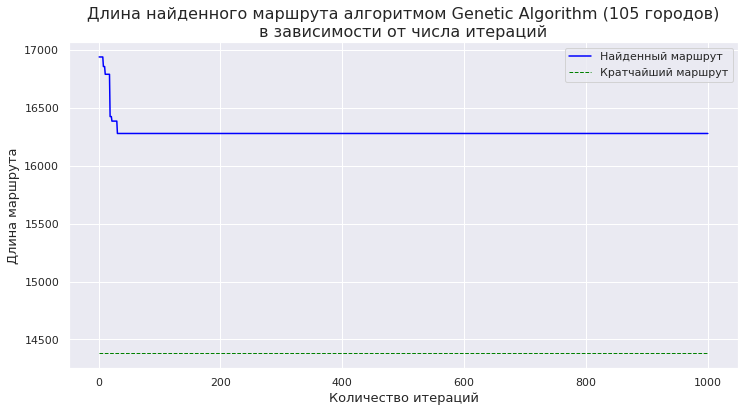

In [ ]:
plot_convergence(tsp, 1000, 'Genetic Algorithm (105 городов)', answer=14379)

In [ ]:
def plot_research(tsp, iterations, title, answer=0):
    plt.figure(figsize=(12, 6))
    grid = np.arange(1, iterations + 1)
    plt.plot(grid, tsp.get_iterations(), color='blue', linewidth=1, label='Наилучшее решение на каждой итерации')
    _, distances = tsp.get_solutions_history()
    plt.plot(grid, distances, color='red', label='Наилучшее решение с начала работы алгоритма')

    if answer != 0:
        plt.plot(grid, np.full(iterations, answer), color='green',
                 linestyle='--', linewidth=1, label='Кратчайший маршрут')

    plt.xlabel('Номер итерации', fontsize=13)
    plt.ylabel('Длина маршрута', fontsize=13)
    plt.title(f'Исследование процесса решения алгоритмом {title}', fontsize=16)
    plt.legend(loc=1)

    plt.savefig(get_file_name('best_result_1000it_10000_roulette_order_in_2opt_0.3_0.1_clever=1_r=1'))
    plt.show()

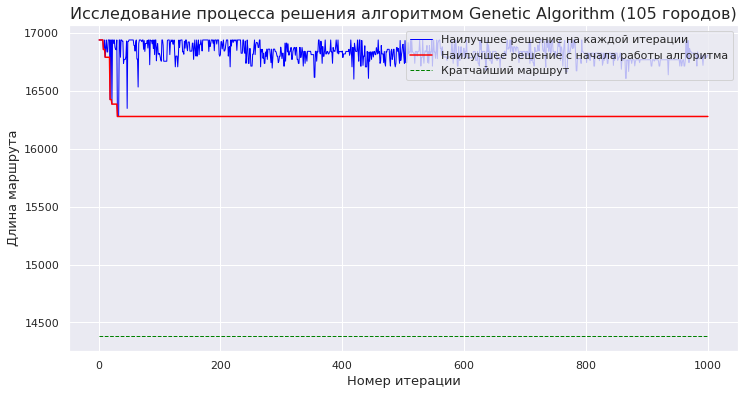

In [ ]:
plot_research(tsp, 1000, 'Genetic Algorithm (105 городов)', answer=14379)

In [ ]:
def plot_deviation(tsp, iterations, title):
    plt.figure(figsize=(12, 6))
    grid = np.arange(1, iterations + 1)
    rmse = tsp.get_ants_distances().std(axis=1)

    plt.plot(grid, rmse, color='blue', linewidth=1)

    plt.xlabel('Номер итерации', fontsize=13)
    plt.ylabel('Среднее квадратическое отклонение', fontsize=13)
    plt.title(f'Исследование RMSE решений по итерациям алгоритма {title}', fontsize=16)

    plt.savefig(get_file_name('deviation'))
    plt.show()

In [ ]:
plot_deviation(tsp, 500, 'Genetic Algorithm (16 городов)')

Сравнение двух алгоритмов

In [ ]:
from ant import AntColony

In [ ]:
def plot_comparison(tsp_ants, tsp_ga, title, answer=0):
    plt.figure(figsize=(12, 6))
    n = len(tsp_ants.get_iterations())
    max_stamp = tsp_ants.get_timestamps()[-1]
    index = 0
    for i in tsp_ga.get_timestamps():
      if i <= max_stamp:
        index += 1

    plt.plot(tsp_ants.get_timestamps(), tsp_ants.get_iterations(), color='blue', label='Муравьиный алгоритм')
    plt.plot(tsp_ga.get_timestamps()[:index], tsp_ga.get_iterations()[:index], color='orange', label='Генетический алгоритм')

    if answer != 0:
        plt.plot(tsp_ants.get_timestamps(), np.full(n, answer), color='green',
                 linestyle='--', linewidth=1, label='Кратчайший маршрут')


    plt.xlabel('Время (в секундах)', fontsize=13)
    plt.ylabel('Длина маршрута', fontsize=13)
    plt.title(title, fontsize=16)
    plt.legend(loc=1)

    plt.savefig(get_file_name('comparison'))
    plt.show()

In [ ]:
file_path = '/content/gdrive/MyDrive/Генетический алгоритм/tests/berlin52.txt'
iterations = 220
ras_settings = AntColony.Settings(alpha=.2, beta=4, rho=0.2, ants=50, iterations=iterations, elitist=7)
ras_colony = AntColony(AntColony.Variation.RANKBASED_ANT_SYSTEM, ras_settings)

In [ ]:
%%time
cities_df, tsp_ants = get_solution(file_path, ras_colony, attempts=1, logging=True)

0
CPU times: user 15min 57s, sys: 5.17 s, total: 16min 2s
Wall time: 16min 3s


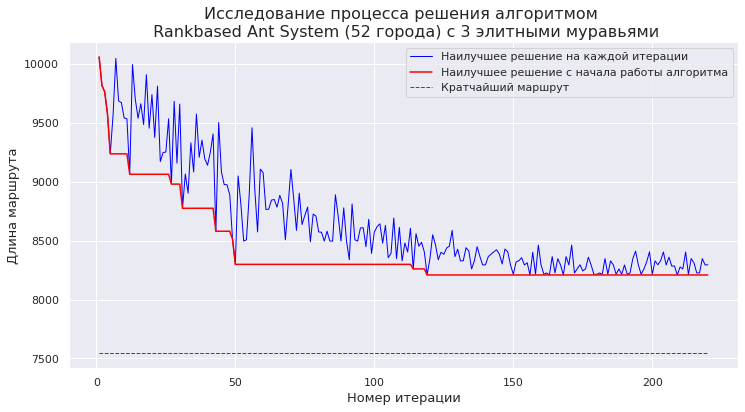

In [ ]:
plot_research(tsp_ants, iterations, '\n Rankbased Ant System (52 города) с 3 элитными муравьями', answer=7542)

In [ ]:
%%time
file_path = '/content/gdrive/MyDrive/Генетический алгоритм/tests/berlin52.txt'

cities_df = get_cities_df(file_path)
tsp_ga_52 = init_tsp(cities_df)
ga_settings = GeneticAlgorithm.Settings(creation = EfficientCreation(10000, tsp_ga_52, 1, 1),
                                               selection = RouletteSelection(0.3),
                                               mutation = TwoOptMutation(0.1),
                                               parent_generator= InbreedingParentGenerator(),
                                               crossover=OrderCrossover(),
                                               iterations=1000,
                                               population_size=10000,
                                               survived=0.3,
                                               mutated=0.1)

ga = GeneticAlgorithm(ga_settings)

tsp_ga_52 = run(tsp_ga_52, ga, attempts=1, logging=True)

0
CPU times: user 13min 53s, sys: 5.26 s, total: 13min 58s
Wall time: 13min 57s


In [ ]:
plot_tsp(cities_df, tsp_ga_52, 'Genetic Algorithm')

In [ ]:
print(tsp_ga.get_iterations())

[473.4148902261736, 479.97771582503384, 457.1155690329483, 457.1155690329483, 479.97771582503384, 446.2025140311946, 446.2025140311946, 445.74668516661615, 450.37850661008116, 438.61942313206725, 446.2025140311946, 459.0839208818356, 427.7990115140665, 442.82824247713063, 442.4408658661675, 429.0940790302146, 429.0940790302146, 421.91109721201906, 421.91109721201906, 448.03998198700384, 391.92275656758744, 416.56076575321066, 416.56076575321066, 424.7420367158045, 424.1682271784773, 424.7420367158045, 434.68857079736114, 437.3796416551937, 413.6782846626358, 429.3524882269657, 396.5826483158158, 422.20144545432333, 434.70175456027744, 422.7988222741002, 443.4098685499609, 446.2025140311946, 445.3468501356862, 423.759944598671, 423.759944598671, 402.9412963699428, 427.2119995311825, 416.75501274024833, 405.65439522015214, 405.65439522015214, 388.7886358623663, 388.7886358623663, 401.68322605134074, 411.9612125243247, 405.9362195743417, 405.9362195743417, 405.9362195743417, 397.610707437

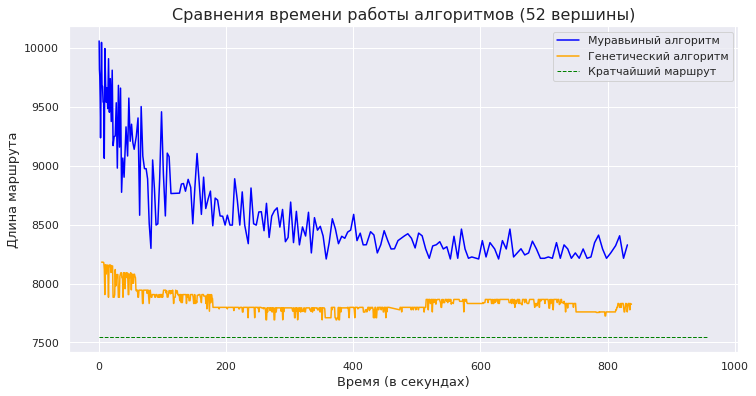

In [ ]:
plot_comparison(tsp_ants, tsp_ga_52, "Сравнения времени работы алгоритмов (52 вершины)", answer=7542)

105 вершин

In [ ]:
file_path = '/content/gdrive/MyDrive/Генетический алгоритм/tests/lin105.txt'
iterations = 100
as_settings = AntColony.Settings(alpha=0.5, beta=5, rho=0.2, ants=100, iterations=iterations)
as_colony = AntColony(AntColony.Variation.ANT_SYSTEM, as_settings)

In [ ]:
%%time
cities_df, tsp_ants_105 = get_solution(file_path, as_colony, attempts=1)

0
CPU times: user 24min 2s, sys: 16.1 s, total: 24min 18s
Wall time: 24min 15s


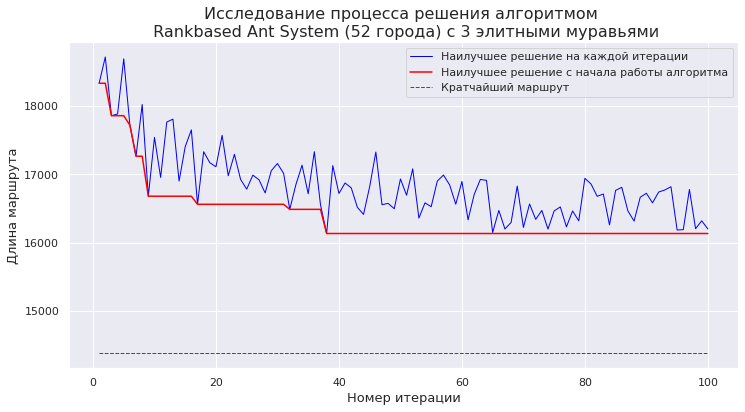

In [ ]:
plot_research(tsp_ants_105, iterations, '\n Rankbased Ant System (52 города) с 3 элитными муравьями', answer=14379)

In [ ]:
%%time
file_path = '/content/gdrive/MyDrive/Генетический алгоритм/tests/lin105.txt'

cities_df = get_cities_df(file_path)
tsp_ga = init_tsp(cities_df)
ga_settings = GeneticAlgorithm.Settings(creation = EfficientCreation(10000, tsp_ga, 1, 1),
                                               selection = RouletteSelection(0.3),
                                               mutation = TwoOptMutation(0.1),
                                               parent_generator= InbreedingParentGenerator(),
                                               crossover=OrderCrossover(),
                                               iterations=1500,
                                               population_size=10000,
                                               survived=0.3,
                                               mutated=0.1)

ga = GeneticAlgorithm(ga_settings)

tsp_ga = run(tsp_ga, ga, attempts=1, logging=True)

0
CPU times: user 36min 6s, sys: 12.2 s, total: 36min 18s
Wall time: 36min 23s


In [ ]:
plot_tsp(cities_df, tsp_ga, 'Genetic Algorithm')

In [ ]:
print(tsp_ants_cheat.get_timestamps()[-1], tsp_ga.get_timestamps()[-1])

1439.5828182697296 71.78866791725159


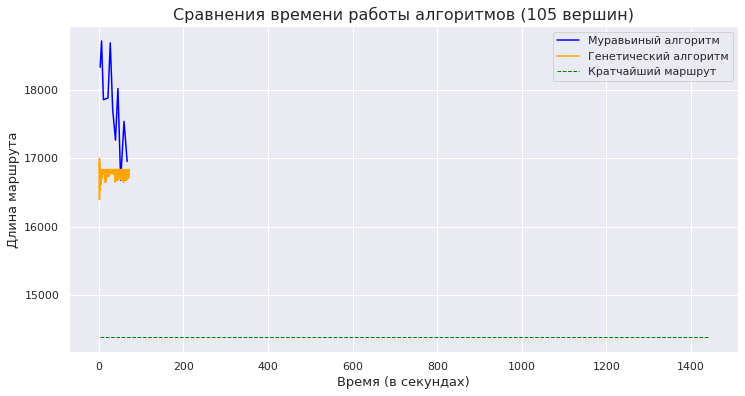

In [ ]:
plot_comparison(tsp_ants_cheat, tsp_ga, "Сравнения времени работы алгоритмов (105 вершин)", answer=14379)

16 вершин

In [ ]:
file_path = '/content/gdrive/MyDrive/Генетический алгоритм/tests/16cities_1.txt'

iterations = 200
ras_settings = AntColony.Settings(alpha=.2, beta=5, rho=0.2, ants=20, iterations=iterations, elitist=7)
ras_colony = AntColony(AntColony.Variation.RANKBASED_ANT_SYSTEM, ras_settings)

In [ ]:
%%time
cities_df, tsp_ants_16 = get_solution(file_path, ras_colony, attempts=1)

0
CPU times: user 7.09 s, sys: 105 ms, total: 7.19 s
Wall time: 7.57 s


In [ ]:
%%time
file_path = '/content/gdrive/MyDrive/Генетический алгоритм/tests/16cities_1.txt'

cities_df = get_cities_df(file_path)
tsp_ga_16 = init_tsp(cities_df)
ga_settings = GeneticAlgorithm.Settings(creation = EfficientCreation(1000, tsp_ga_16, 1, 1),
                                               selection = RouletteSelection(0.3),
                                               mutation = TwoOptMutation(0.1),
                                               parent_generator= InbreedingParentGenerator(),
                                               crossover=OrderCrossover(),
                                               iterations=500,
                                               population_size=1000,
                                               survived=0.3,
                                               mutated=0.1)

ga = GeneticAlgorithm(ga_settings)

tsp_ga_16 = run(tsp_ga_16, ga, attempts=1, logging=True)

0
CPU times: user 17.2 s, sys: 159 ms, total: 17.3 s
Wall time: 17.3 s


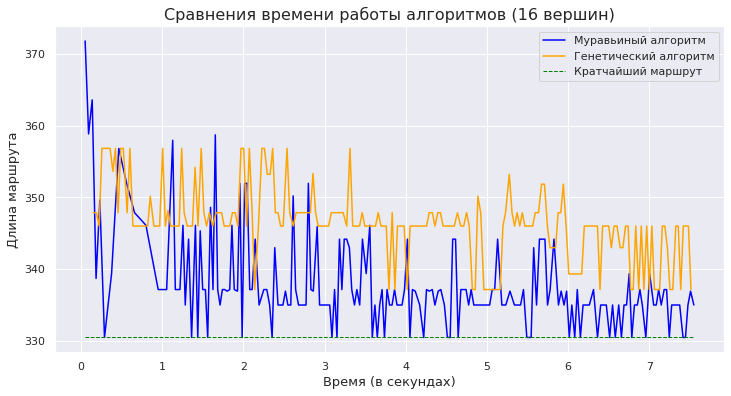

In [ ]:
plot_comparison(tsp_ants_16, tsp_ga_16, "Сравнения времени работы алгоритмов (16 вершин)", answer=330.5)